In [4]:

import numpy as np
import matplotlib.pylab as plt
import glob
from datetime import datetime, timedelta
import sys
import xarray as xr
from matplotlib import rc
import matplotlib.animation as animation
import matplotlib as mpl
import cartopy.crs as ccrs
import os
import cartopy
from scipy.sparse import csr_matrix, load_npz, save_npz
import scipy.sparse.linalg as sla
import cmocean


from timeit import default_timer as timer



In [5]:
sys.path.insert(0,'.')    # '.' is in the same folder
%load_ext autoreload
%autoreload 1
#  Reload all modules imported with %aimport every time before executing the Python code typed.

# %cd /home/students/6252699/thesis/parcels2/
%aimport advect_ice
%aimport plot_functions
%aimport transition_matrices

%matplotlib inline

import functions.lay_out
plt.style.use(['default'])


In [6]:
import matplotlib as mpl
plt.style.use(['default'])

################################################################

# plotting parameters
mpl.rcParams['font.size'] = 14
mpl.rcParams['font.weight'] = 'normal'

mpl.rcParams["figure.figsize"] = [8 , 4]
mpl.rcParams['legend.fontsize'] = 12      #legend size
#title params
mpl.rcParams['axes.titlesize'] = 20
mpl.rcParams['axes.titleweight'] = 'bold'
mpl.rcParams['font.style'] = 'italic'    #all fonts italic
#axes params
mpl.rcParams['axes.labelsize'] = 16
mpl.rcParams["xtick.labelsize"] = 13
mpl.rcParams["ytick.labelsize"] = 13
# line width and grid
mpl.rcParams['lines.linewidth'] = 2
mpl.rcParams["axes.grid"] = 1
# mpl.rcParams["figure.subplot.left"] = 0.05
# mpl.rcParams["figure.subplot.right"] = 0.1
# mpl.rcParams["figure.subplot.bottom"] = 0.11
mpl.rcParams["savefig.bbox"] = 'tight'
mpl.rcParams["savefig.pad_inches"] = 0.1
mpl.rcParams['legend.loc'] =  'best'

# colors
COLOR = 'black'
mpl.rcParams['text.color'] = COLOR
mpl.rcParams['axes.labelcolor'] = COLOR
mpl.rcParams['xtick.color'] = COLOR
mpl.rcParams['ytick.color'] = COLOR


In [18]:
class run_properties():
    
    def __init__(self, file_name):
        
        self.file_name    = file_name
        seperated         = self.file_name.split('_')
        
        if seperated[1]=="million-particles":
            self.simdays   = seperated[3]
            self.start_str = seperated[5]
            self.kernel    = seperated[-1].split('.')[0]

            
        else:         
            self.run_date     = seperated[0]
            self.npart        = seperated[2]
            self.start_str    = seperated[4]   #string of the starting date
            self.simdays      = seperated[6]
            self.kernel       = (seperated[-2] + seperated[-1]).split('.')[0]
        self.start_obj    = datetime.strptime(self.start_str, "%Y-%m-%d").date() #object of the starting date
    
    def describe_properties(self):
        '''
        method giving a description of the properties
        '''
        print('The run date is  {}'.format(self.run_date))
        print('N. particles   : {}'.format(self.npart))
        print('Starting date  : {}'.format(self.start_str ))
        print('Simulated days : {}'.format(self.simdays))
        print('Kernel used    : {}'.format(self.kernel))
        

In [10]:
data_dir = "/scratch/AnnekeV/output/11-4-combination-two-runs/"
fig_dir  = "/home/students/6252699/thesis/parcels2/figures/"

In [11]:
ice_files      = glob.glob(data_dir + "*prob.nc")
ice_long_2016  = glob.glob(data_dir + "*2016-02-01*prob.nc")

In [13]:
ice_long_2016

['/scratch/AnnekeV/output/11-4-combination-two-runs/03-13_npart_487791_start_2016-02-01_simdays_60_kernel_AdvectionRK4_prob.nc',
 '/scratch/AnnekeV/output/11-4-combination-two-runs/04-08_npart_488373_start_2016-02-01_simdays_60_kernel_AdvectionRK4_prob.nc']

In [14]:
test_early = xr.open_dataset(ice_long_2016[0], decode_times=False)
test_late  = xr.open_dataset(ice_long_2016[1], decode_times=False)

====================================================================================================================================
## Combining the dataset for ice such that they can be used together
====================================================================================================================================

In [15]:
def test_if_no_overlap(ds1, ds2):
    counter = 0
    for lat1 in ds1.lat.isel(obs=0).values[0:400000:176]:
        for lat2 in ds2.lat.isel(obs=0).values[0:400000:176]:
            if lat1==lat2: counter+=1
    if counter >1e-10: 
        print(counter)
        print(ice_files[i], ice_files[j])
        print("There might be sth wrong")
        
        
for i in range(len(ice_files)):
    for j in np.arange(i+1,len(ice_files), dtype=int):
        prop1 = run_properties(ice_files[i])
        prop2 = run_properties(ice_files[j])
        if prop1.start_obj == prop2.start_obj:
            print("\n{}".format(prop1.start_obj))
            name = "combined/04-11_million-particles_simdays_{}_start_{}_kernel_{}.nc".format(prop1.simdays, prop1.start_str, prop1.kernel)
            ds1 = xr.open_dataset(ice_files[i], decode_times=False)
            ds2 = xr.open_dataset(ice_files[j], decode_times=False)
            if os.path.isfile(data_dir + name):
                print("This date has already been combined")
                test_if_no_overlap(ds1,ds2)

            else:
                try: 
                    ds_combined = xr.open_mfdataset([ice_files[i],ice_files[j]], decode_times=False, concat_dim="traj")
                    ds_combined.to_netcdf(data_dir + name)
                except: 
                    print("Apparently it didn't work to combine: \n{} \n{}".format(ice_files[i], ice_files[j]))
                    print("Lengths are respectively {} and {}".format(len(ds1.obs.values), len(ds2.obs.values)))




NameError: name 'run_properties' is not defined

====================================================================================================================================
# Images
====================================================================================================================================

In [19]:
combined_files = sorted(glob.glob(data_dir+ "combined/*"))
combined_files

print len(combined_files)
for i in combined_files:
    prop = run_properties(i)
    print prop.start_str
    
print combined_files

9
2014-02-21
2015-02-21
2016-02-21
2014-02-11
2015-02-11
2016-02-11
2014-02-01
2015-02-01
2016-02-01
['/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2014-02-21_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2015-02-21_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2016-02-21_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2014-02-11_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2015-02-11_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2016-02-11_kernel_AdvectionRK4prob.nc', '/scratch/AnnekeV/output/11-4-combination-two-runs/c

# To run all of them

In [ ]:
line     = "\n-----------------------------------------------------------------------------\n"



timespan = 1800 #days
            
for filename in combined_files: 
    print(line)
    prop = run_properties(filename)
    days = eval(prop.simdays)
    times = timespan/days +1
    year  = prop.start_obj.year
    for res in [2,1]:
        T, latbins_bering, lonbins_bering, M_bering = transition_matrices.trans_mat_digit(filename, res=res, final_index =-1, in_ice = False, void = True)
        transition_matrices.movement_strait(M_bering,latbins_bering, lonbins_bering, days = days, times=times, strait = "Bering", year=year, nr_subplots = 4, ice_extent = False)
#         plt.savefig(fig_dir + "transitionplots/04_16/Bering/time_evolution_1800_days_res_{}_simdays_{}_year_{}.png".format(int(res*10), days, year), bbox_inches="tight", pad_inches=0.1)

    print(filename + "\n")
    plt.show()


# To run a single evolution file

In [ ]:
def times(timespan, simdays):
    return int(timespan/simdays +1)

times(2400,40)

In [ ]:
res      = 1

year     = 2015
simdays  = 40
ts_bering, ts_norway = 1800, 360
findfile = sorted(glob.glob(data_dir+ "combined/*simdays_{}_*{}*".format(simdays,year)))[0]

T, latbins, lonbins, M = transition_matrices.trans_mat_digit(findfile, res=res, final_index =-1, in_ice = False, void = True)
transition_matrices.movement_strait(M, latbins, lonbins, days=simdays, year=year, nr_subplots = 4, ice_extent = False,
                                    times=times(ts_bering,simdays), strait = "Bering")
plt.savefig(fig_dir + "transitionplots/04_16/Bering/bering_time_evolution_{}_days_res_{}_simdays_{}_year_{}.png".format(ts_bering, int(res*10), days, year), 
            bbox_inches="tight", pad_inches=0.1)

transition_matrices.movement_strait(M, latbins, lonbins, days=simdays, year=year, nr_subplots = 4, ice_extent = False,
                                    times=times(ts_norway,simdays), strait = "Norway")
plt.savefig(fig_dir + "transitionplots/04_16/Norway_time_evolution_{}_days_res_{}_simdays_{}_year_{}.png".format(ts_norway, int(res*10),days,year), 
            bbox_inches="tight", pad_inches=0.1)

# Bering

In [ ]:



timespan = 1800 #days
strait   = "Bering"
ax_width = 4


for res in [1, 2]:
    
    
    vmax  = 1
    vmin  = 1e-6
     
        
    '''Make sure the grid looks nice''' 
    r,c = transition_matrices.grid_subplots(len(combined_files))   #nr of rows (r) and columns (c) in the grid
    
    '''Initialize figure raster of 6'''
    count = 0
    fig   = plt.figure(figsize = [c*ax_width, r*ax_width])
    fig.suptitle(strait + ", resolution = {} deg".format(res), fontsize=20)

    
    for filename in combined_files: 
        count+=1; print count
        prop = run_properties(filename)
        days = eval(prop.simdays)
        times = timespan/days +1
        year  = prop.start_obj.year
        
 
        '''Set up axes'''
        ax = fig.add_subplot(r, c, count, projection=ccrs.NorthPolarStereo())
        ax = transition_matrices.set_subaxes(ax) 
        ax.add_feature(cartopy.feature.LAND, facecolor = (0,0,0,.8), edgecolor = (0,0,0,0) )

        '''Calculate and Plot the final distribution'''
        T, latbins_bering, lonbins_bering, M_bering = transition_matrices.trans_mat_digit(filename, res=res, final_index =-1, in_ice = False, void = True)
        R    = transition_matrices.final_R(M_bering,latbins_bering, lonbins_bering, days = days, times=times, strait = strait, year=year)
        nlat, nlon = len(latbins_bering)-1,len(lonbins_bering)-1 
        ncels = nlat*nlon
        p    = ax.pcolormesh(lonbins_bering, latbins_bering, R[-1, 0:ncels].reshape(nlat,nlon),   
                             norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), 
                             cmap = 'viridis',
                            transform = ccrs.PlateCarree())
        
        '''Extent'''
        extentdate = datetime.datetime.strptime("{}-03-01".format(year), "%Y-%m-%d").date()
        plot_functions.plot_extent_contour(extentdate, ax)
        ax.set_title("{} days, {}".format(days, year) )  

        
   
    
    fig.subplots_adjust(bottom = 0.10)
    cbar_ax = fig.add_axes([0.15, 0.06, 0.7, .03])
    cbar = fig.colorbar(p, cax=cbar_ax, orientation = 'horizontal', extend = 'max')
    
    plt.savefig(fig_dir + "transitionplots/04_16/Bering/final_comparison_1800_days_individual_years_res_{}.png".format(int(res*10)), bbox_inches="tight", pad_inches=0.1)


    

# Norwegian Sea

In [ ]:



timespan = 360 #days
strait   = "Norway"
ax_width = 4


for res in [1, 2]:
    
    
    vmax  = 1
    vmin  = 1e-6
     
        
    '''Make sure the grid looks nice''' 
    r,c = transition_matrices.grid_subplots(len(combined_files))   #nr of rows (r) and columns (c) in the grid
    
    '''Initialize figure'''
    count = 0
    fig   = plt.figure(figsize = [c*ax_width, r*ax_width])
    fig.suptitle(strait + ", resolution = {} deg".format(res), fontsize=20)

    
    for filename in combined_files: 
        count+=1; print count
        prop = run_properties(filename)
        days = eval(prop.simdays)
        times = timespan/days +1
        year  = prop.start_obj.year
        
 
        '''Set up axes'''
        ax = fig.add_subplot(r, c, count, projection=ccrs.NorthPolarStereo())
        ax = transition_matrices.set_subaxes(ax) 
        ax.add_feature(cartopy.feature.LAND, facecolor = (0,0,0,.8), edgecolor = (0,0,0,0) )

        '''Calculate and Plot the final distribution'''
        T, latbins_Norway, lonbins_Norway, M_Norway = transition_matrices.trans_mat_digit(filename, res=res, final_index =-1, in_ice = False, void = True)
        R    = transition_matrices.final_R(M_Norway,latbins_Norway, lonbins_Norway, days = days, times=times, strait = strait, year=year)
        nlat, nlon = len(latbins_Norway)-1,len(lonbins_Norway)-1 
        ncels = nlat*nlon
        p    = ax.pcolormesh(lonbins_Norway, latbins_Norway, R[-1,0:ncels].reshape(nlat,nlon),   
                             norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), 
                             cmap = 'viridis',
                            transform = ccrs.PlateCarree())
        
        '''Extent'''
        extentdate = datetime.datetime.strptime("{}-03-01".format(year), "%Y-%m-%d").date()
        plot_functions.plot_extent_contour(extentdate, ax)
        ax.set_title("{} days, {}".format(days, year) )  

        
   
    
    fig.subplots_adjust(bottom = 0.10)
    cbar_ax = fig.add_axes([0.15, 0.06, 0.7, .03])
    cbar = fig.colorbar(p, cax=cbar_ax, orientation = 'horizontal', extend = 'max')
    
    plt.savefig(fig_dir + "transitionplots/04_16/Norwegian_Sea_final_comparison_360_days_individual_years_res_{}.png".format(int(res*10)), bbox_inches="tight", pad_inches=0.1)
    plt.show()

    

====================================================================================================================================
# With added years

In [7]:

def trans_mat_digit_mf(ds_names, res, final_index =-1, in_ice = False, void = True, sink = True):
    '''
    Makes a transition matrix.
    ds_names = the name of the multiple files (incl. direcotry)
    res     = resolution
    final_index in case you don't want it to be the last value
    ===============================================
    Returns Transition matrix, latbins, lonbins, sparse matrix
    '''
    
    nfiles = len(ds_names)
    ncels  = int ((360//res) * (40//res))
    superT = np.zeros((ncels+1,ncels+1))

    
    for f in range(nfiles):
        ds = xr.open_mfdataset(ds_names[f], decode_times = False)

        N   = 360//res

        lons_i   = ds.lon.isel(obs= 0).values
        lats_i   = ds.lat.isel(obs= 0).values
        lons_f   = ds.lon.isel(obs= final_index).values
        lats_f   = ds.lat.isel(obs= final_index).values

        print("Opened dataset")

        nparts              = len(lons_i)
        particle_grid_index = np.zeros((2, nparts), dtype=int)

        if in_ice:
            in_ice_i = ds.in_ice.isel(obs=0).values  
            in_ice_f = ds.in_ice.isel(obs=final_index).values
            T        = np.zeros((ncels*2+1,ncels*2+1))

        else:
            in_ice_i = np.zeros(np.shape(lons_i))
            in_ice_f = np.zeros(np.shape(lons_i))
            T        = np.zeros((ncels+1,ncels+1))


        '''Find initial indices'''
        for i in range(nparts):
            if np.isnan(lons_i[i]) or np.isnan(lats_i[i]) :
                particle_grid_index[0,i] = -1
            else:
                particle_grid_index[0,i] = int((lats_i[i]-50)//res)*N  + int((lons_i[i]+ 180)//res) + int(in_ice_i[i]) * ncels

        '''Find final indices'''
        for i in range(nparts):
            if np.isnan(lons_f[i]) or np.isnan(lats_f[i]):
                particle_grid_index[1,i] = -1
            else:
                particle_grid_index[1,i] = int((lats_f[i]-50)//res)*N  + int((lons_f[i]+ 180)//res) + int(in_ice_f[i]) * ncels

        for i in range(nparts):
            T[particle_grid_index[1,i], particle_grid_index[0,i]] += 1

        superT += T
        
    print("Made transition matrix")
    '''Normalize matrix'''
    sumT =  np.sum(superT, axis=0)
    sumT[sumT ==0] = 1
    superT /=sumT

    '''Remove sinks'''
    if sink:
        max_sink = (np.diag(superT)[:-1]).max()
        count    = 0
        while (max_sink == 1 and count <10):
            superT        = transition_matrices.remove_sinks(superT)
            count   += 1
            max_sink = (np.diag(T)[:-1]).max()
        print ("Count removal for sinks is {}" .format(count))

    superT[:,-1]  = 0   # all nan's go to nan
    superT[-1,-1] = 1

    
    
    if void: 
        zeros = np.where(superT.sum(axis=0)==0)[0]
        Tkopy = superT.copy()[:,:]
        Tkopy[zeros,:] = 0 
        sumTkopy =  np.sum(Tkopy, axis=0)
        sumTkopy[sumTkopy ==0] = 1.
        Tkopy = Tkopy/sumTkopy
        superT = Tkopy.copy()[:,:]
        
    latbins, lonbins= np.arange(50,90+res, res),  np.arange(-180,180+res, res)          
    M_sparse = csr_matrix(superT)
    print("Done with T")

    return superT, latbins , lonbins, M_sparse

In [22]:
combined_files_per_year = [combined_files[0:3], combined_files[3:6], combined_files[6:9]]
combined_files_per_year

[['/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2014-02-21_kernel_AdvectionRK4prob.nc',
  '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2015-02-21_kernel_AdvectionRK4prob.nc',
  '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_20_start_2016-02-21_kernel_AdvectionRK4prob.nc'],
 ['/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2014-02-11_kernel_AdvectionRK4prob.nc',
  '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2015-02-11_kernel_AdvectionRK4prob.nc',
  '/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_40_start_2016-02-11_kernel_AdvectionRK4prob.nc'],
 ['/scratch/AnnekeV/output/11-4-combination-two-runs/combined/04-11_million-particles_simdays_60_start_2014-02-01_kernel_AdvectionRK4prob.nc

# Calculate percentage that doesn't leave location

In [142]:

for i in range(3):
    ds = xr.open_mfdataset(combined_files_per_year[i], decode_times = False)

    lat_dis = abs(ds.lat.isel(obs=0)-ds.lat.isel(obs=-1))
    lon_dis = abs(ds.lon.isel(obs=0)-ds.lon.isel(obs=-1)).values

    for i in range(len(lon_dis)):
        if lon_dis[i] > 180:
            lon_dis[i] = abs(lon_dis[i]-360)
    dis = lat_dis+lon_dis


    a     = np.count_nonzero(dis)
    ndays = ds.lat.shape[1]*5-5
    npart = len(dis)
    
    print("{} days \n-------------".format(ndays))
    print("Number that doesn't move:")
    print("{:.3f} %".format( np.float( npart-a)/npart*100))
    print("{} particles".format(npart-a))
    print("\n")
    
    
    a = np.count_nonzero(np.isnan(ds.lat.isel(obs=-1)))
    b = np.count_nonzero(np.isnan(ds.lon.isel(obs=-1)))
    assert a==b


    print("Number that ends in nan:" )
    print("{:.3f} %".format( np.float(a)/npart*100))
    print("{} particles".format(a))
    print("\n")

    


20 days 
-------------
Number that doesn't move:
0.002 %
50 particles


Number that ends in nan:
0.850 %
24888 particles


40 days 
-------------
Number that doesn't move:
0.001 %
22 particles


Number that ends in nan:
1.570 %
45986 particles


60 days 
-------------
Number that doesn't move:
0.001 %
16 particles


Number that ends in nan:
2.125 %
62239 particles




In [19]:
start = timer()

end   = timer()
print("{:.1f} s".format(end-start))

0.0 s


# line

In [208]:
res = 1

def get_line(res,loni=140,lonf=240, lati=75,latf=75):
    '''Set up line'''
    lons = np.arange(loni,lonf, res)
    n_samples = len(lons)
    lats =  np.linspace(lati,latf,n_samples)
    return lons, lats
    
    
    

def sample_and_plot_along_latitude(Rfinal,res,labels):
    '''
    Plot the accumulation of tracer along a latitude
    Rfinal = a list of arrays of the final distribution
    res    = resolution of Rfinal
    labels = labels given to each line
    '''
    lons, lats     = get_line(res)
    lons_plot      = lons.copy()[:]
    lons[lons>180] = -(360 - lons[lons>180])    # transfer to lons to west 

    N              = 360//res
    grid_index     = np.array((lats-50)//res, dtype=int)*N  + np.array((lons+ 180)//res, dtype=int)
    plt.figure(figsize = [6,5])
    for i in range(np.min(np.shape(Rfinal))):
        plt.plot(lons_plot, Rfinal[i][grid_index], marker='o', label = "{}".format(labels[i]), markersize=1)
    plt.legend()
    plt.ylabel("Tracer Accumulation Factor")
    plt.xlim([lons_plot[0],lons_plot[-1]+res])
    ymax = 10/res
    plt.ylim([0,10/res])
    plt.yticks(np.arange(0,ymax+1,2), np.arange(0,ymax+1,2))
    if  (lons_plot[0]==140) and (lons_plot[-1]==240-res):
        plt.xticks(np.arange(140,260,20), [r"$140^oE$" , r"$160^oE$", r"$180^oE$", r"$160^oW$", r"$140^oW$", r"$120^oW$"])
    else:
        plt.xlabel("Degrees east")






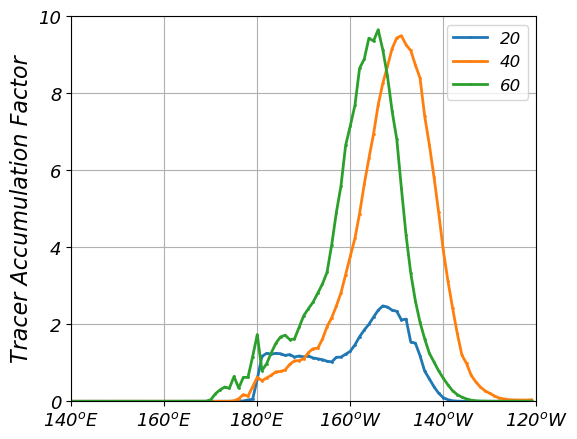

In [209]:
sample_and_plot_along_latitude(Rfinal3,1,days3)

1

2.7 s
2

5.5 s
3

8.4 s


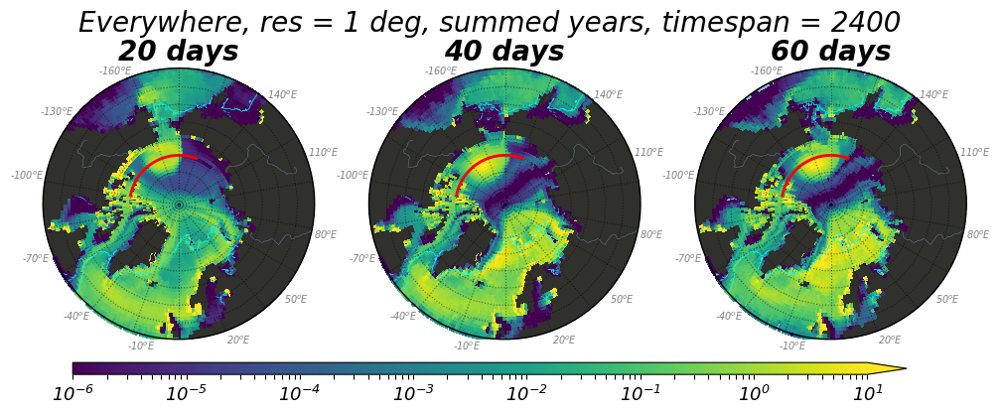

In [158]:

start = timer()

year     = 2015
ax_width = 4




# for strait in ["Norway", "Bering", "Everywhere"]:
for strait in ["Everywhere"]:
    if   strait == "Norway": timespan = 360  # days
    elif strait == "Bering": timespan = 1800 # days
    elif strait == "Everywhere": timespan = 2400
    else: print("Something is wrong, \n you didn't loop over a strait"); continue
        

    for res in [1]:


        vmax  = 10
        vmin  = 1e-6


        '''Make sure the grid looks nice''' 
        r,c = transition_matrices.grid_subplots(len(combined_files_per_year))   #nr of rows (r) and columns (c) in the grid

        '''Initialize figure'''
        count = 0
        fig   = plt.figure(figsize = [c*ax_width, r*ax_width])
        fig.suptitle(strait + ", res = {} deg, summed years, timespan = {}".format(res, timespan), fontsize=20)
        
        Rfinal3,days3 = [], []

        for filename in combined_files_per_year: 
            count+=1; print count
            
            days_try, year_try = np.arange(3), np.zeros(3)
            
            for l in range(len(filename)): 
                prop         = run_properties(filename[l])
                days_try[l]  = eval(prop.simdays)
                year_try[l]  = prop.start_obj.year
            assert (days_try[0]==days_try[1])
            assert (days_try[1]==days_try[2])
            assert (year_try[0]!=year_try[1])
            assert (year_try[2]!=year_try[1])
            days = days_try[0]
            
                                       
            times = timespan/days +1


            '''Set up axes'''
            ax = fig.add_subplot(r, c, count, projection=ccrs.NorthPolarStereo())
            ax = transition_matrices.set_subaxes(ax) 
            ax.add_feature(cartopy.feature.LAND, facecolor = (0,0,0,.8), edgecolor = (0,0,0,0) )

            '''Calculate and Plot the final distribution'''
            T, latbins, lonbins, M = trans_mat_digit_mf(filename, res=res, final_index =-1, in_ice = False, void = True)
#             T, M, lonbins, latbins = load_transition_matrices(days=days, res=res, year=year)

            R_full  = transition_matrices.final_R(M,latbins, lonbins, days = days, times=times, strait = strait, year=year)
            R       = R_full[-1,:]
            nlat, nlon = len(latbins)-1,len(lonbins)-1 
            ncels   = nlat*nlon
            p       = ax.pcolormesh(lonbins, latbins, R[0:ncels].reshape(nlat,nlon),   
                                     norm = mpl.colors.LogNorm(vmin = vmin, vmax = vmax), 
                                     cmap = 'viridis',
                                     transform = ccrs.PlateCarree())
            lons, lats = get_line(res)
            ax.plot(lons,lats, color = 'red', transform = ccrs.PlateCarree())

            '''Extent'''
            extentdate = datetime.datetime.strptime("{}-03-01".format(2015), "%Y-%m-%d").date()
            plot_functions.plot_extent_contour(extentdate, ax)
            ax.set_title("{} days".format(days) )  
#             plot_functions.add_grid_labels(ax,-160,170,50,90,30,10, latlabels=False, fontsize=7, alpha =.5)
            plot_functions.set_circular_boundary(ax)
            
            print("{:.1f} s".format(timer()-start))
            
            Rfinal3.append(R)
            days3.append(days)
        
        
    



        bottom_subplot = 0.10 / r
            
        fig.subplots_adjust(bottom = bottom_subplot)
        cbar_ax = fig.add_axes([0.15, 0.06, 0.7, bottom_subplot*.3])   #left, bottom, width , height
        cbar = fig.colorbar(p, cax=cbar_ax, orientation = 'horizontal', extend = 'max')

#         plt.savefig(fig_dir + "transitionplots/04_16/{}_final_comparison_{}_days_summed_years_res_{}.png".format(strait, timespan, int(res*10)), bbox_inches="tight", pad_inches=0.1)
#         plt.show()

        
    

0 %

4 %

8 %

12 %

17 %

21 %

25 %

29 %

33 %

38 %

42 %

46 %

50 %

54 %

58 %

62 %

67 %

71 %

75 %

79 %

83 %

88 %

92 %

96 %



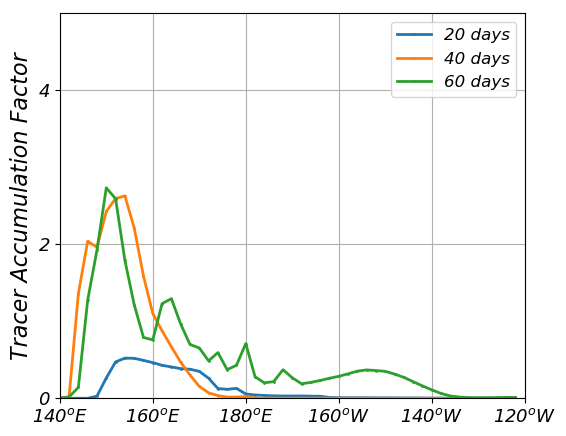

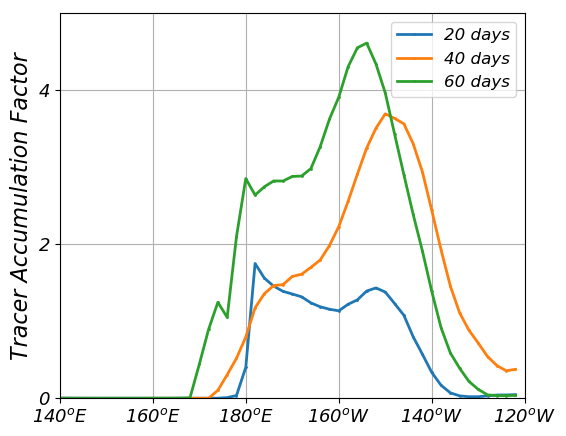

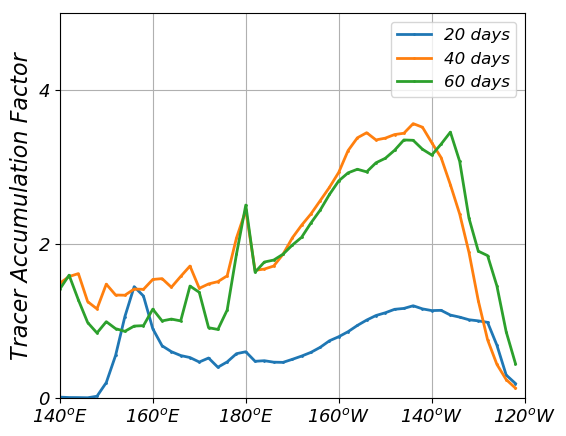

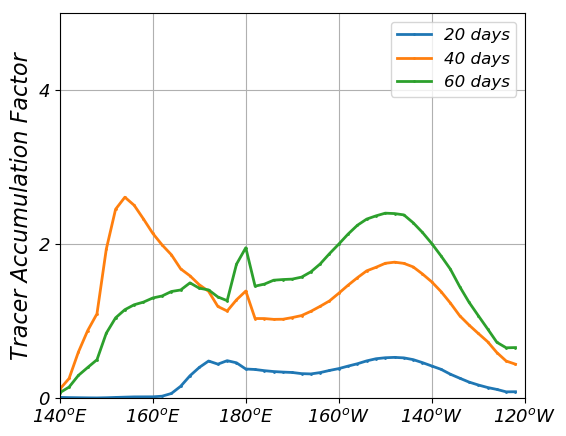

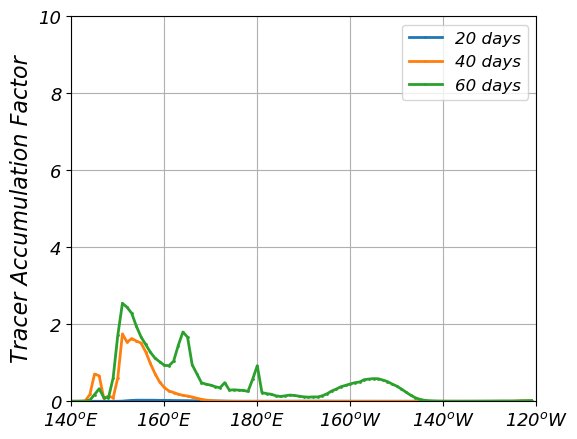

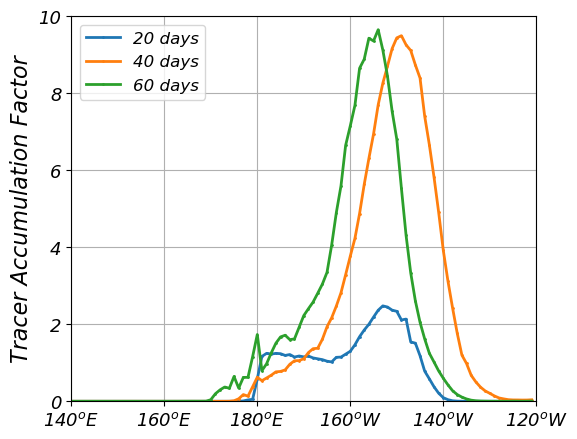

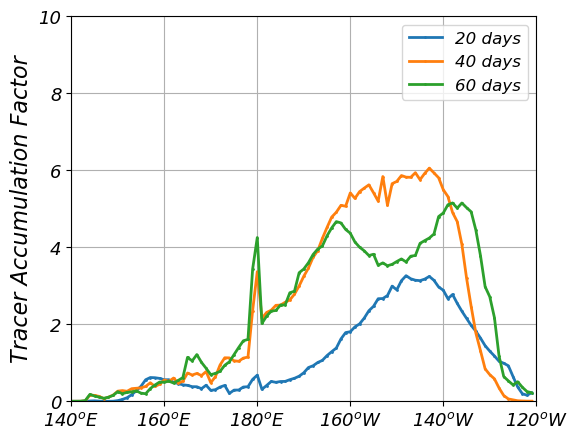

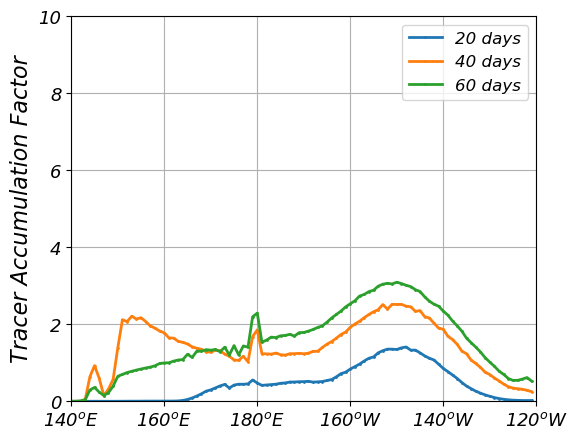

In [214]:
count     = 0.
maxloop   = 24.
timespan  = 2400


path = fig_dir + "taf/per_res_per_year/"
if not os.path.exists(path): os.makedirs(path)       

for res in [2,1]:
    for year in [2014,2015,2016,0]:

        Rfinal = []
        label  = []
        for days in [20,40,60]:

            print("{:.0f} %".format(np.float(count/maxloop)*100.))
            count+=1.
                        
            times = timespan/days +1

            T, M, lonbins, latbins = load_transition_matrices(days=days, res=res, year=year)
            R_full  = transition_matrices.final_R(M,latbins, lonbins, days = days, times=times, strait = 'Everywhere', year=year)
            Rfinal.append(R_full[-1,:])
            
            if year == 0: year_name="All years"
            else: year_name = str(year)
            label.append("{} days".format(days))
        
        sample_and_plot_along_latitude(Rfinal=Rfinal, res=res, labels=label)
#         plt.title("{}, {} degree".format(year_name, res))
        plt.savefig(path + "taf_res_{}_yr_{}".format(res,year),
                    bbox_inches="tight", pad_inches=0.1)


        
plt.show()




====================================================================================================================================
# Make transition matrices
====================================================================================================================================

In [30]:
out_dir = "/scratch/AnnekeV/transition_matrices/"

In [31]:
background = combined_files[-2]

In [32]:
start = timer()


year = 2015
days = 60
res = .5

filenames = [background]



'''Calculate and save the transition matrix'''
T, latbins, lonbins, M = trans_mat_digit_mf(filenames, res=res, final_index =-1, in_ice = False, void = True)
np.save(out_dir + "T" + "_year_{}_simdays_{}_res_{}".format(year, days, 5), T)
np.save(out_dir + "lonbins_" + "res_{}".format(5), lonbins)
np.save(out_dir + "latbins_" + "res_{}".format(5), latbins)
save_npz(out_dir + "M" + "_year_{}_simdays_{}_res_{}".format(year,days, 5), M)

print("{:.0f} s".format(timer()-start))


Opened dataset
Made transition matrix
Count removal for sinks is 1
Done with T
201 s


In [ ]:
start = timer()

for res in [1, 2]:

    for filenames in combined_files_per_year: 

        days_try, year_try = np.arange(3), np.zeros(3)

        for l in range(len(filenames)): 
            prop         = run_properties(filenames[l])
            days_try[l]  = eval(prop.simdays)
            year_try[l]  = prop.start_obj.year
        assert (days_try[0]==days_try[1])
        assert (days_try[1]==days_try[2])
        assert (year_try[0]!=year_try[1])
        assert (year_try[2]!=year_try[1])
        days = days_try[0]


        '''Calculate and save the transition matrix'''
        T, latbins, lonbins, M = trans_mat_digit_mf(filenames, res=res, final_index =-1, in_ice = False, void = True)
        np.save(out_dir + "T" + "_added_years_" + "simdays_{}_res_{}".format(days, res), T)
        np.save(out_dir + "lonbins_" + "res_{}".format(res), lonbins)
        np.save(out_dir + "latbins_" + "res_{}".format(res), latbins)
        save_npz(out_dir + "M" + "_added_years_" + "simdays_{}_res_{}".format(days, res), M)

        print("{:.0f} s".format(timer()-start))




In [177]:
start = timer()

for res in [1, 2]:
    for days in [20,40,60]: 
        '''Calculate and save the transition matrix'''
        T = np.load(out_dir + "T" + "_added_years_" + "simdays_{}_res_{}.npy".format(days, res))
        save_npz(out_dir + "M" + "_added_years_" + "simdays_{}_res_{}".format(days, res), csr_matrix(T))
        
        for year in [2014,2015,2016]:
            T = np.load(out_dir  + "T" + "_year_{}_simdays_{}_res_{}.npy".format(year, days, res))
            save_npz(out_dir  + "M" + "_year_{}_simdays_{}_res_{}".format(year, days, res), csr_matrix(T))


        print("{:.0f} s".format(timer()-start))




15 s
30 s
45 s
46 s
47 s
48 s


====================================================================================================================================
# Eigenvectors
====================================================================================================================================

In [13]:
plt.close()

days = 20
res  = 1

def load_transition_matrices(days, res, year = 0): 
    '''
    Loads the transition matrices from the file, based on simulation lenght, resolution and year. Default is combined years
    '''

    lonbins = np.load(out_dir + "lonbins_" + "res_{}.npy".format(res))
    latbins = np.load(out_dir + "latbins_" + "res_{}.npy".format(res))
    
    if year == 0:
        M = load_npz(out_dir + "M" + "_added_years_" + "simdays_{}_res_{}.npz".format(days, res))
        T = np.load(out_dir  + "T" + "_added_years_" + "simdays_{}_res_{}.npy".format(days, res))
    else: 
        M = load_npz(out_dir + "M" + "_year_{}_simdays_{}_res_{}.npz".format(year, days, res))
        T = np.load(out_dir  + "T" + "_year_{}_simdays_{}_res_{}.npy".format(year, days, res))
    
    return T, M, lonbins, latbins

# T, M, lonbins, latbins = load_transition_matrices(days, res)



Calculated right eigenvectors, currently plotting


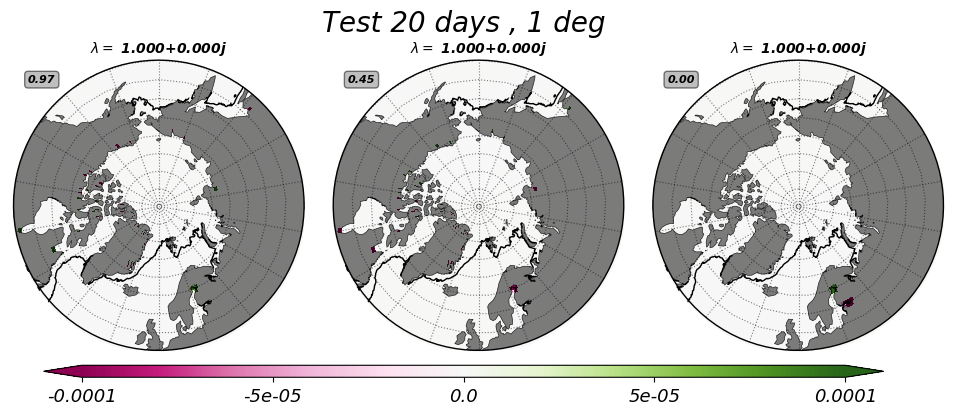

In [216]:
days = 20
res  = 1

title = "Test {} days , {} deg".format(days, res)
date  = "2015-03-01"



T, M, lonbins, latbins = load_transition_matrices(days, res)
transition_matrices.right_eigen_vector_grid(M=M, latbins=latbins, lonbins=lonbins, title = title, k=2, date = date)
plt.savefig(fig_dir + "transitionplots/04_24/plot_for_colorbar.png", bbox_inches="tight", pad_inches=0.1)



Calculated right eigenvectors, currently plotting
4 %
Calculated right eigenvectors, currently plotting


/home/students/6252699/miniconda2/envs/parcels2/lib/python2.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


8 %
Calculated right eigenvectors, currently plotting
12 %
Calculated right eigenvectors, currently plotting
17 %
Calculated right eigenvectors, currently plotting
21 %
Calculated right eigenvectors, currently plotting
25 %
Calculated right eigenvectors, currently plotting
29 %
Calculated right eigenvectors, currently plotting
33 %
Calculated right eigenvectors, currently plotting
38 %
Calculated right eigenvectors, currently plotting
42 %
Calculated right eigenvectors, currently plotting
46 %
Calculated right eigenvectors, currently plotting
50 %
Calculated right eigenvectors, currently plotting
54 %
Calculated right eigenvectors, currently plotting
58 %
Calculated right eigenvectors, currently plotting
62 %
Calculated right eigenvectors, currently plotting
67 %
Calculated right eigenvectors, currently plotting
71 %
Calculated right eigenvectors, currently plotting
75 %
Calculated right eigenvectors, currently plotting
79 %
Calculated right eigenvectors, currently plotting
83 %
Calcul

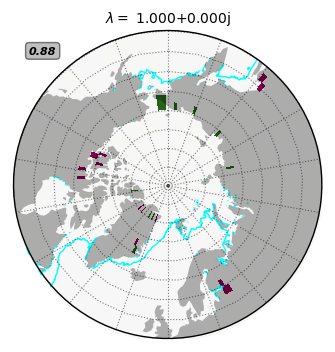

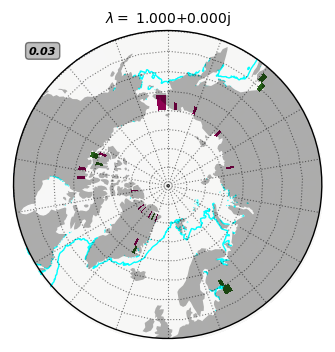

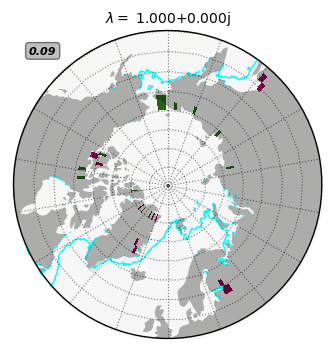

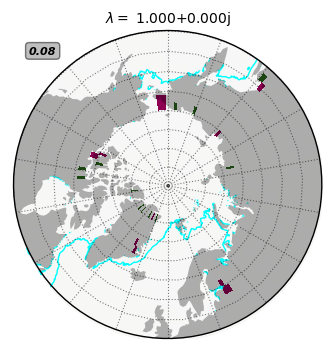

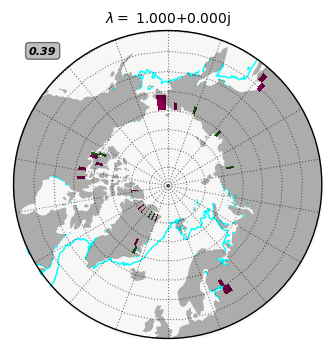

...

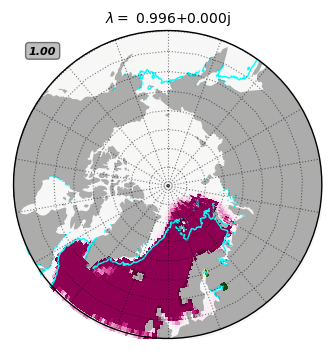

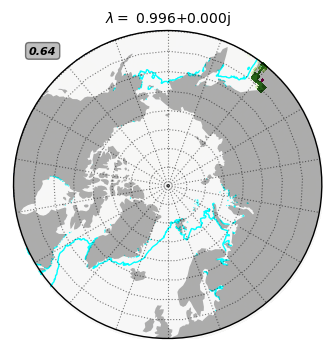

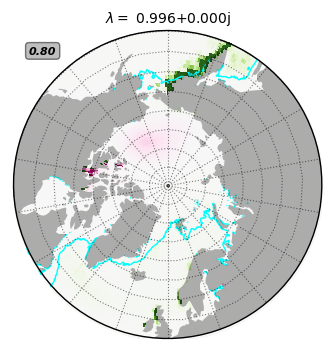

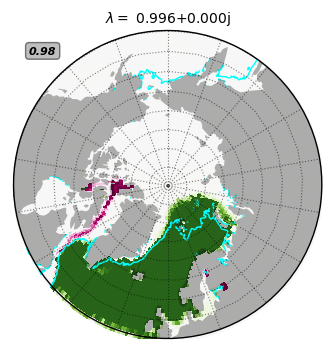

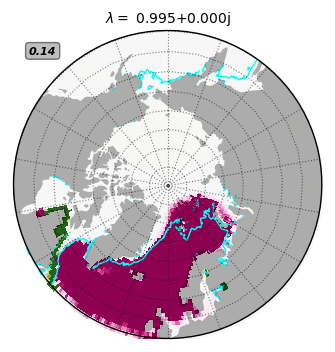

In [18]:
count   = 0.
maxloop = 24.

for year in [2014,2015,2016,0]:
    for res in [2,1]:
        for days in [20,40,60]:
            count+=1.
            T, M, lonbins, latbins = load_transition_matrices(days=days, res=res, year=year)
            transition_matrices.right_eigen_vector_single(M=M, latbins=latbins, lonbins=lonbins, res=res, year=year,days=days, k=15, date = date, colorbar=False, savefig=True)
            
            print("{:.0f} %".format(np.float(count/maxloop)*100.))


In [16]:
print "hello"

hello


====================================================================================================================================
# Animations
====================================================================================================================================

In [ ]:
import numpy as np
import netCDF4 as netcdf
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy
import cartopy.crs as ccrs
import cmocean
import gc
import os
import imageio
import xarray as xr
from matplotlib import rc
import re
import datetime
from functions.grid_to_km import area
import matplotlib.animation as animation


fig_dir       = "/home/students/6252699/thesis/parcels2/figures/"

import matplotlib as mpl

################################################################
plt.style.use(['default'])

# plotting parameters
mpl.rcParams['font.size'] = 14
mpl.rcParams['font.weight'] = 'normal'

mpl.rcParams["figure.figsize"] = [8 , 4]
mpl.rcParams['legend.fontsize'] = 12      #legend size
#title params
mpl.rcParams['axes.titlesize'] = 20
mpl.rcParams['axes.titleweight'] = 'bold'
mpl.rcParams['font.style'] = 'italic'    #all fonts italic
#axes params
mpl.rcParams['axes.labelsize'] = 16
mpl.rcParams["xtick.labelsize"] = 13
mpl.rcParams["ytick.labelsize"] = 13
# line width and grid
mpl.rcParams['lines.linewidth'] = 2
mpl.rcParams["axes.grid"] = 1
# mpl.rcParams["figure.subplot.left"] = 0.05
# mpl.rcParams["figure.subplot.right"] = 0.1
# mpl.rcParams["figure.subplot.bottom"] = 0.11
mpl.rcParams["savefig.bbox"] = 'tight'
mpl.rcParams["savefig.pad_inches"] = 0.1
mpl.rcParams['legend.loc'] =  'best'

def set_fig():
    fig = plt.figure(figsize = [8,8])
    ax = plt.axes(projection=ccrs.NorthPolarStereo())
    ax.gridlines(xlocs = np.arange(-180,185,20), ylocs = np.arange(-90, 95,5), color='black', alpha=0.5, linestyle=':')
    ax.add_feature(cartopy.feature.OCEAN, facecolor = "lightseagreen" )
    ax.add_feature(cartopy.feature.LAND, facecolor=cartopy.feature.COLORS['land'])
#     ax.stock_img()
    ax.set_extent([-180,180,50,90],  ccrs.PlateCarree())
#     ax.coastlines()
  
    return fig,ax 

def set_axes():
    '''Returns ax with no coastlines'''
    plt.figure(figsize = [8,8])
    ax = plt.axes(projection=ccrs.NorthPolarStereo())
    ax.gridlines(xlocs = np.arange(-180,185,20), ylocs = np.arange(-90, 95,5), color='black', alpha=0.5, linestyle=':')
    ax.add_feature(cartopy.feature.OCEAN)
    ax.add_feature(cartopy.feature.LAND)
    ax.set_extent([-180,180,50,90],  ccrs.PlateCarree())
#     ax.coastlines()
    ax.stock_img()
    return ax


def plot_animation(fname, fname2, color_var="sic", label_name = "Sea ice concentration", save_gif = False, specific_savename = ""):
    '''
    Plot an animation for a certain output file FNAME from parcels. COLOR_VAR define variable on which color should be based. LABEL_NAME the label of the colorbar. In order to save the output, use save_gif = TRUE, SPECIFIC_SAVENAME is a  string to specify an extra variable          for the name when saved. 
    NEW VERSION OF PLOT GIF
    '''
    
    ds = xr.open_dataset(fname, decode_times=False)
    ds2 = xr.open_dataset(fname2, decode_times=False)
    N  = np.size(ds.lat,1)
    start_date = plot_functions.find_start_date(ds.time.units)
    time       = start_date
    
    # Initialize figure 
    fig, ax = set_fig()
    ax.set_extent([-20,20, 60,80])
    scat = ax.scatter(ds.lon.values[:,0], ds.lat.values[:,0], s =.1, transform = ccrs.PlateCarree() , color = 'purple')
    scat2 = ax.scatter(ds2.lon.values[:,0], ds2.lat.values[:,0], s =.1, transform = ccrs.PlateCarree() , color = 'blue')
    ttl  = ax.set_title("{:d}/{:02d}/{:02d}".format(time.year,time.month, time.day) )
#     cbar = plt.colorbar(scat)
#     cbar.set_label(label_name)
    
    print("Background is made")
    
    def update_loc(t):
        scat.set_offsets(np.vstack((ds.lon.values[:,t],   ds.lat.values[:,t])).transpose())
        scat2.set_offsets(np.vstack((ds2.lon.values[:,t], ds2.lat.values[:,t])).transpose())
        
        time_values = ds.time.values[:,t]   # in case there infinite time values
        time = start_date + datetime.timedelta(seconds=time_values[np.isfinite(time_values)][0])        
        ttl.set_text("{:d}/{:02d}/{:02d}".format(time.year,time.month, time.day) )
        return scat, scat2
    rc('animation', html='html5')
    anim = animation.FuncAnimation(fig, update_loc, frames=range(1,N), interval=300, blit=False)
    print("Animation is done")
    
    
    if save_gif: anim.save(fig_dir + 'animations/animation_startdate_{:d}{:02d}{:02d}_timesteps_{}_{}_{}_small.gif'.format(
        start_date.year,start_date.month, start_date.day, N, color_var, specific_savename), 
                           writer='imagemagick', fps=10)
    print("Done")
    plt.close()
    
    return anim




In [ ]:
plot_animation(ice_long_2016[0], save_gif=True)

In [ ]:
plot_animation(fname = ice_long_2016[0], fname2=ice_long_2016[1], save_gif=True)